**Partial differential equations!**
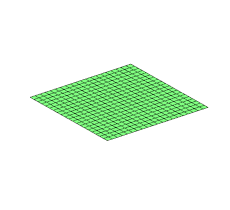

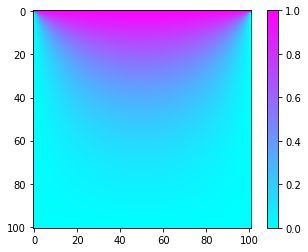

In [ ]:
# Laplace's equation for a box at 1 V on the top, 0 V on the sides
from numpy import empty,zeros,max
from pylab import imshow,colorbar,show
import pylab as plt

M = 100
V = 1.0
target = 1e-5

phi = zeros([M+1,M+1],float)
phi[0,:] = V
phiprime = empty([M+1,M+1],float)

delta = 1.0
while delta > target:
  for i in range(M+1):
    for j in range(M+1):
      if i == 0 or i == M or j == 0 or j == M:
        phiprime[i,j] = phi[i,j]
      else:
        phiprime[i,j] = (phi[i+1,j]+phi[i-1,j] + phi[i,j+1] + phi[i,j-1]) / 4       
  delta = max(abs(phi-phiprime))
  phi,phiprime = phiprime, phi

imshow(phi,cmap=plt.get_cmap('cool'))
colorbar()
show()

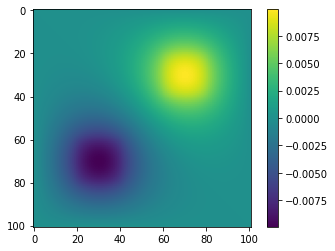

In [ ]:
# Exercise 9.1

from numpy import empty,zeros,max
from pylab import imshow, colorbar,show

# Constants
L = 1.0 # box length
M = 100 # squares on a side
a = L/M # size of square 
rho0 = 1.0 # Charge density
epsilon0 = 1.0 # our units
target = 1e-6 # Target accuracy

# Create arrays
phi = zeros([M+1,M+1],float)
phiprime = zeros([M+1,M+1],float)
rho = zeros([M+1,M+1],float)
rho[20:41,60:81] = rho0
rho[60:81,20:41] = -rho0

# Main loop
delta = 1.0
while delta > target:
  # Calculate new values of potential
  phiprime[0,:] = 0.0
  phiprime[M,:] = 0.0
  phiprime[:,0] = 0.0
  phiprime[:,M] = 0.0
  phiprime[1:M,1:M] = (phi[0:M-1,1:M] + phi[2:M+1,1:M] + phi[1:M,0:M-1] + phi[1:M,2:M+1])/4 \
                           + rho[1:M,1:M]*a*a/(4*epsilon0)
  # Calculate max change
  delta = max(abs(phi-phiprime))
  # Swap the two arrays
  phi,phiprime = phiprime,phi

# Make plot
imshow(phi)
colorbar()
show()





In [ ]:
# Laplace's equation for a box at 1 V on the top, 0 V on the sides
# Exercise 9.2, over-relaxation
from numpy import empty,zeros,max
from pylab import imshow,colorbar,show
import pylab as plt
import time

def runLaplaceOverRelax(omega = 0.9):
  L = 1.0
  M = 100
  V = 1.0
  target = 1e-6
  tstart = time.perf_counter()
  phi = zeros([M+1,M+1],float)
  phi[0,:] = V
  dphi = zeros([M+1,M+1],float)
  delta = 1.0
  while delta > target:
    for i in range(1,M):
      for j in range(1,M):
        dphi[i,j] = (1.+omega)*((phi[i+1,j] + phi[i-1,j] + phi[i,j+1] + phi[i,j-1]) / 4 - phi[i,j])       
        phi[i,j] += dphi[i,j]
    delta = max(abs(dphi))
  imshow(phi,cmap=plt.get_cmap('cool'))
  colorbar()
  show()
  tend = time.perf_counter()
  print("Omega = ",omega," and it took",(tend - tstart)," seconds")


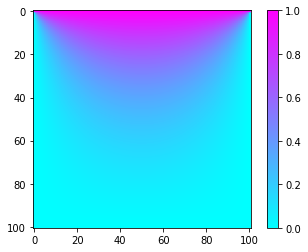

Omega =  0.9  and it took 10.56870855399984  seconds


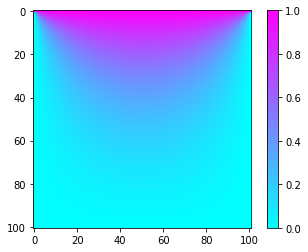

Omega =  0.8  and it took 22.417167475000042  seconds


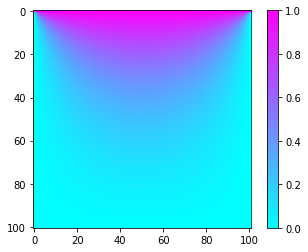

Omega =  0.1  and it took 126.85352892300011  seconds


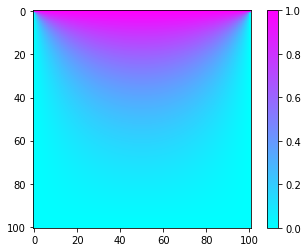

Omega =  0.0  and it took 145.62474876800025  seconds


In [ ]:
runLaplaceOverRelax(0.9)
runLaplaceOverRelax(0.8)
runLaplaceOverRelax(0.1)
runLaplaceOverRelax(0.0)


In [ ]:
runLaplaceOverRelax(1.0) ## This doesn't converge!

KeyboardInterrupt: ignored

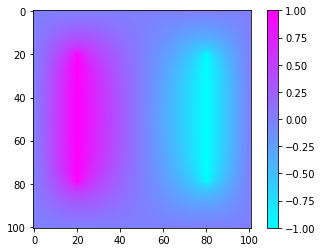

In [ ]:
## Exercise 9.3, capacitor using Gauss-Seidel and over-relaxation

from numpy import zeros,max
from pylab import imshow, show, colorbar

L = 0.1
N = 100
a = L/N
clo = N//5
chi = 4*N//5
omega = 0.9

## Set up initial values and boundary array
phi = zeros([N+1,N+1],float)
phi[clo:chi,clo] = +1.0
phi[clo:chi,chi] = -1.0

# Store where plates are located
plates = zeros([N+1,N+1],int)
plates[clo:chi,clo] = 1
plates[clo:chi,chi] = 1

# Solve for phi
delta = 1.0
target = 1e-6
while delta > target:
  delta = 0.0
  for i in range(1,N):
    for j in range(1,N):
      if plates[i,j] == 0:
        oldphi = phi[i,j]
        phi[i,j] = (1+omega)*(phi[i+1,j] + phi[i-1,j] + phi[i,j+1] + phi[i,j-1])/4 - omega*phi[i,j]
        epsilon = abs(phi[i,j] - oldphi)
        if (epsilon > delta): delta = epsilon

# Draw results
imshow(phi,cmap=plt.get_cmap('cool'))
colorbar()
show()



Animation size has reached 20978388 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


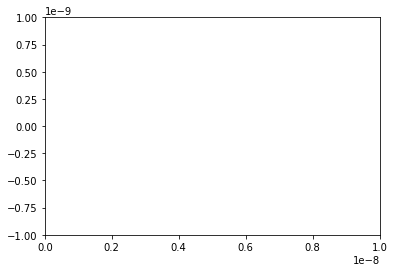

In [ ]:
# Exercise 9.8 Schrodinger
from numpy import empty, arange, linspace, exp, real, full
import matplotlib.pyplot as plt
import matplotlib.animation as animation
#from banded import banded
from matplotlib import rc
from IPython.display import HTML
from numpy import copy

def banded(Aa,va,up,down):

    # Copy the inputs and determine the size of the system
    A = copy(Aa)
    v = copy(va)
    N = len(v)

    # Gaussian elimination
    for m in range(N):

        # Normalization factor
        div = A[up,m]

        # Update the vector first
        v[m] /= div
        for k in range(1,down+1):
            if m+k<N:
                v[m+k] -= A[up+k,m]*v[m]

        # Now normalize the pivot row of A and subtract from lower ones
        for i in range(up):
            j = m + up - i
            if j<N:
                A[i,j] /= div
                for k in range(1,down+1):
                    A[i+k,j] -= A[up+k,m]*A[i,j]

    # Backsubstitution
    for m in range(N-2,-1,-1):
        for i in range(up):
            j = m + up - i
            if j<N:
                v[m] -= A[i,j]*v[j]

    return v

#constants
L = 1.0e-8
N = 1000
a = L/N
m = 9.109e-31
hbar = 1.055e-34
x0 = L/2
sigma = 1.0e-10
kappa = 5.0e10

tmax = 1.0e-12
yscale = 1e-9
h = 5e-19
###h = 1e-16

C = 1j*hbar/(4*m*a*a)
a1 = 1 + 2*h*C
a2 = -h*C
b1 = 1 - 2*h*C
b2 = h*C

# Create the initial arrays of x and psi values
x = linspace(0,L,N+1)
psi = exp(-(x-x0)**2/(2*sigma**2))*exp(1j*kappa*x)
psi[0] = psi[N] = 0
# Create the tridiagonal array A
A = empty([3,N-1],complex)
A[0,:] = a2
A[1,:] = a1
A[2,:] = a2

def init():
    line.set_data([], [])
    return line,


def animate(i):
    ## main loop for the Crank-Nicolson method
    v = b2*psi[0:N-1] + b1*psi[1:N] + b2*psi[2:N+1]
    psi[1:N] = banded(A,v,1,1)
    ys = yscale*real(psi)
    line.set_data(x,ys)
    return line,


fig = plt.figure()
ax = plt.axes(xlim=(0, L), ylim=(-yscale,yscale))
line, = ax.plot([], [], lw=3)

ani = animation.FuncAnimation(fig, animate, interval=50, frames = 5000, init_func=init)
# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
ani

###plt.show()

